<a href="https://colab.research.google.com/github/bhavyaKumawat/Doughnut-Detection-using-TFOD-API/blob/main/training.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Install the TensorFlow Object Detection API

In [1]:
# clone the master branch of the Tensorflow Models repository
! git clone --depth 1 https://github.com/tensorflow/models.git

Cloning into 'models'...
remote: Enumerating objects: 3219, done.
remote: Counting objects: 100% (3219/3219), done.
remote: Compressing objects: 100% (2732/2732), done.
remote: Total 3219 (delta 863), reused 1352 (delta 443), pack-reused 0
Receiving objects: 100% (3219/3219), 33.42 MiB | 29.78 MiB/s, done.
Resolving deltas: 100% (863/863), done.


In [2]:
import os
os.chdir("models/research")

In [3]:
%%writefile use_protobuf.py

import os
import sys
args = sys.argv
directory = args[1]
for file in os.listdir(directory):
    if file.endswith(".proto"):
        os.system("protoc "+directory+"/"+file+" --python_out=.")

Writing use_protobuf.py


In [4]:
# Compile protos.
! python use_protobuf.py object_detection/protos 

In [5]:
# Install TensorFlow Object Detection API
%%bash
cp object_detection/packages/tf2/setup.py .
python -m pip install .

Processing /content/models/research
  Created wheel for object-detection: filename=object_detection-0.1-py3-none-any.whl size=1683460 sha256=0d0425f9eeb7688a2d42d2806d1c551800bbe82b8d2a0d61d1aee476bfec787c
  Stored in directory: /tmp/pip-ephem-wheel-cache-t4h_t0jg/wheels/fa/a4/d2/e9a5057e414fd46c8e543d2706cd836d64e1fcd9eccceb2329
  Created wheel for py-cpuinfo: filename=py_cpuinfo-8.0.0-py3-none-any.whl size=22258 sha256=c3284a156d4db43b4577c53d34e31aac277b2719b10d1143cffadbaea386c425
  Stored in directory: /root/.cache/pip/wheels/d2/f1/1f/041add21dc9c4220157f1bd2bd6afe1f1a49524c3396b94401
  Created wheel for avro-python3: filename=avro_python3-1.9.2.1-py3-none-any.whl size=43512 sha256=9ff1c7e55ff25db9f948eed944daeacd08217d66d7d6f2e40e9e6dd26314930a
  Stored in directory: /root/.cache/pip/wheels/bc/49/5f/fdb5b9d85055c478213e0158ac122b596816149a02d82e0ab1
  Created wheel for dill: filename=dill-0.3.1.1-py3-none-any.whl size=78546 sha256=0f4c04f45595ed87943b60baa0f0d97e67440695cb0c71345

  DEPRECATION: A future pip version will change local packages to be built in-place without first copying to a temporary directory. We recommend you use --use-feature=in-tree-build to test your packages with this new behavior before it becomes the default.
   pip 21.3 will remove support for this functionality. You can find discussion regarding this at https://github.com/pypa/pip/issues/7555.
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
multiprocess 0.70.12.2 requires dill>=0.3.4, but you have dill 0.3.1.1 which is incompatible.
google-colab 1.0.0 requires requests~=2.23.0, but you have requests 2.26.0 which is incompatible.
datascience 0.10.6 requires folium==0.2.1, but you have folium 0.8.3 which is incompatible.


In [6]:
# To test the installation run
! python object_detection/builders/model_builder_tf2_test.py

Running tests under Python 3.7.12: /usr/bin/python3
[ RUN      ] ModelBuilderTF2Test.test_create_center_net_deepmac
2021-12-22 21:35:41.483522: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
W1222 21:35:41.914604 140511668664192 model_builder.py:1100] Building experimental DeepMAC meta-arch. Some features may be omitted.
INFO:tensorflow:time(__main__.ModelBuilderTF2Test.test_create_center_net_deepmac): 3.29s
I1222 21:35:42.225203 140511668664192 test_util.py:2309] time(__main__.ModelBuilderTF2Test.test_create_center_net_deepmac): 3.29s
[       OK ] ModelBuilderTF2Test.test_create_center_net_deepmac
[ RUN      ] ModelBuilderTF2Test.test_create_center_net_model0 (customize_head_params=True)
INFO:tensorflow:time(__main__.ModelBuilderTF2Test.test_create_center_net_model0 (customize_head_params=True)): 0.62s
I1222 21:35:42.842120 140511668664192 test

## Load annotations
* Move about 80% to the  <code>object_detection/images/train</code> directory and the other 20% to the <code>object_detection/images/test</code> directory.

In [7]:
# create directories
! mkdir object_detection/images object_detection/images/train object_detection/images/test

In [8]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [9]:
path = "/content/drive/MyDrive/Colab Notebooks (1)/Doughnuts"

from shutil import copyfile
copyfile( os.path.join(path, 'annotations2.json') , 'annotations.json')

'annotations.json'

## Split the dataset and annotations

In [10]:
# Simple tool to split coco annotations into train and test sets
! git clone https://github.com/akarazniewicz/cocosplit.git

Cloning into 'cocosplit'...
remote: Enumerating objects: 17, done.
remote: Counting objects: 100% (6/6), done.
remote: Compressing objects: 100% (3/3), done.
remote: Total 17 (delta 3), reused 3 (delta 3), pack-reused 11
Unpacking objects: 100% (17/17), done.


In [11]:
os.chdir("cocosplit")
# install basic set of dependencies
! pip install -r requirements.txt

In [12]:
# run
! python cocosplit.py -s 0.8 ../annotations.json ../object_detection/images/train.json ../object_detection/images/test.json

Saved 130 entries in ../object_detection/images/train.json and 33 in ../object_detection/images/test.json


In [13]:
os.chdir("../")

In [14]:
# Load images

import json
src = os.path.join(path, 'dataset2')
train_dst = "object_detection/images/train"
test_dst = "object_detection/images/test"

with open('object_detection/images/train.json') as f:
  train = json.load(f)
  for image in train["images"]:
    file_name = image["file_name"]    
    copyfile(os.path.join(src, file_name), os.path.join(train_dst, file_name))

with open('object_detection/images/test.json') as f:
  test = json.load(f)
  for image in test["images"]:
    file_name = image["file_name"]    
    copyfile(os.path.join(src, file_name), os.path.join(test_dst, file_name))

## Create the TFRecord files from the COCO format
* TensorFlow Object Detection API only supports TFRecord format

In [15]:
# repository to Convert raw COCO dataset to TFRecord for object_detection
! git clone https://github.com/TannerGilbert/Tensorflow-Object-Detection-API-train-custom-Mask-R-CNN-model.git

os.chdir("Tensorflow-Object-Detection-API-train-custom-Mask-R-CNN-model")

Cloning into 'Tensorflow-Object-Detection-API-train-custom-Mask-R-CNN-model'...
remote: Enumerating objects: 386, done.
remote: Counting objects: 100% (3/3), done.
remote: Compressing objects: 100% (3/3), done.
remote: Total 386 (delta 0), reused 1 (delta 0), pack-reused 383
Receiving objects: 100% (386/386), 83.69 MiB | 17.95 MiB/s, done.
Resolving deltas: 100% (25/25), done.


In [16]:
! python create_coco_tf_record.py --logtostderr --train_image_dir=../object_detection/images/train --test_image_dir=../object_detection/images/test --train_annotations_file=../object_detection/images/train.json --test_annotations_file=../object_detection/images/test.json --include_masks=True --output_dir=../object_detection

INFO:tensorflow:Found groundtruth annotations. Building annotations index.
I1222 21:41:23.607782 140345224963968 create_coco_tf_record.py:214] Found groundtruth annotations. Building annotations index.
INFO:tensorflow:0 images are missing annotations.
I1222 21:41:23.608212 140345224963968 create_coco_tf_record.py:227] 0 images are missing annotations.
INFO:tensorflow:On image 0 of 130
I1222 21:41:23.608583 140345224963968 create_coco_tf_record.py:232] On image 0 of 130
INFO:tensorflow:On image 100 of 130
I1222 21:41:30.177670 140345224963968 create_coco_tf_record.py:232] On image 100 of 130
INFO:tensorflow:Finished writing, skipped 0 annotations.
I1222 21:41:32.038554 140345224963968 create_coco_tf_record.py:239] Finished writing, skipped 0 annotations.
INFO:tensorflow:Found groundtruth annotations. Building annotations index.
I1222 21:41:32.040886 140345224963968 create_coco_tf_record.py:214] Found groundtruth annotations. Building annotations index.
INFO:tensorflow:0 images are missi

In [17]:
os.chdir("../")

## Download the pre-trained model
* Select the model from [Model Zoo](https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/tf2_detection_zoo.md), download and unzip it, and put it in workspace/test/pre-trained-models

In [18]:
# Download the checkpoint
!wget http://download.tensorflow.org/models/object_detection/tf2/20200711/mask_rcnn_inception_resnet_v2_1024x1024_coco17_gpu-8.tar.gz

--2021-12-22 21:41:35--  http://download.tensorflow.org/models/object_detection/tf2/20200711/mask_rcnn_inception_resnet_v2_1024x1024_coco17_gpu-8.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 74.125.197.128, 2607:f8b0:400e:c06::80
Connecting to download.tensorflow.org (download.tensorflow.org)|74.125.197.128|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 484546405 (462M) [application/x-tar]
Saving to: ‘mask_rcnn_inception_resnet_v2_1024x1024_coco17_gpu-8.tar.gz’

mask_rcnn_inception 100%[===================>] 462.10M   156MB/s    in 3.0s    

2021-12-22 21:41:38 (156 MB/s) - ‘mask_rcnn_inception_resnet_v2_1024x1024_coco17_gpu-8.tar.gz’ saved [484546405/484546405]



In [19]:
! mkdir object_detection/checkpoint_dir

In [20]:
!tar -xf mask_rcnn_inception_resnet_v2_1024x1024_coco17_gpu-8.tar.gz

In [21]:
from distutils.dir_util import copy_tree
copy_tree('mask_rcnn_inception_resnet_v2_1024x1024_coco17_gpu-8/checkpoint/',  'object_detection/checkpoint_dir')

['object_detection/checkpoint_dir/ckpt-0.data-00000-of-00001',
 'object_detection/checkpoint_dir/ckpt-0.index',
 'object_detection/checkpoint_dir/checkpoint']

## Create a Label map and a training Configuration file

* Creating a Label map
  * The Label map maps  <code>id -> name</code>. We will put it in a folder called <code>training</code>, which is located in the object_detection directory.

In [22]:
! mkdir object_detection/training

In [23]:
%%writefile object_detection/training/labelmap.pbtxt

item {
    id: 1
    name: 'Strawberry Frosted'
}
item {
    id: 2
    name: 'Chocolate Frosted'
}
item {
    id: 3
    name: 'Boston Cream'
}
item {
    id: 4
    name: 'Sugar Glazed'
}

Writing object_detection/training/labelmap.pbtxt


* Creating the training Configuration file
  * Copy the config file to the training directory

In [24]:
src = "object_detection/configs/tf2/mask_rcnn_inception_resnet_v2_1024x1024_coco17_gpu-8.config"

copyfile(src, os.path.join("object_detection/training", "mask_rcnn_inception_resnet_v2_1024x1024_coco17_gpu-8.config")  )

'object_detection/training/mask_rcnn_inception_resnet_v2_1024x1024_coco17_gpu-8.config'

In [25]:
! ls object_detection/training

labelmap.pbtxt	mask_rcnn_inception_resnet_v2_1024x1024_coco17_gpu-8.config


In [26]:
os.chdir("object_detection")

In [27]:
%%writefile /content/models/research/object_detection/training/mask_rcnn_inception_resnet_v2_1024x1024_coco17_gpu-8.config


# Mask R-CNN with Inception Resnet v2 (no atrous)
# Sync-trained on COCO (with 8 GPUs) with batch size 16 (1024x1024 resolution)
# Initialized from Imagenet classification checkpoint
#
# Train on GPU-8
#
# Achieves 40.4 box mAP and 35.5 mask mAP on COCO17 val

model {
  faster_rcnn {
    number_of_stages: 3
    num_classes: 4   # Modify to the number of objects that need to be identified.
    image_resizer {
      fixed_shape_resizer {
        height: 400
        width: 400
      }
    }
    feature_extractor {
      type: 'faster_rcnn_inception_resnet_v2_keras'
    }
    first_stage_anchor_generator {
      grid_anchor_generator {
        scales: [0.25, 0.5, 1.0, 2.0]
        aspect_ratios: [0.5, 1.0, 2.0]
        height_stride: 16
        width_stride: 16
      }
    }
    first_stage_box_predictor_conv_hyperparams {
      op: CONV
      regularizer {
        l2_regularizer {
          weight: 0.0
        }
      }
      initializer {
        truncated_normal_initializer {
          stddev: 0.01
        }
      }
    }
    first_stage_nms_score_threshold: 0.0
    first_stage_nms_iou_threshold: 0.7
    first_stage_max_proposals: 100 # Faster R-CNN has two networks, the first proposes regions where objects may be found and the second tries to detect objects in those.
    #Increasing the number of proposals by the first network increases the accuracy but implies more computational work, because the second network has to search in more potential areas.
    first_stage_localization_loss_weight: 2.0
    first_stage_objectness_loss_weight: 1.0
    initial_crop_size: 17
    maxpool_kernel_size: 1
    maxpool_stride: 1
    second_stage_box_predictor {
      mask_rcnn_box_predictor {
        use_dropout: false
        dropout_keep_probability: 1.0
        fc_hyperparams {
          op: FC
          regularizer {
            l2_regularizer {
              weight: 0.0
            }
          }
          initializer {
            variance_scaling_initializer {
              factor: 1.0
              uniform: true
              mode: FAN_AVG
            }
          }
        }
        mask_height: 33
        mask_width: 33
        mask_prediction_conv_depth: 0
        mask_prediction_num_conv_layers: 4
        conv_hyperparams {
          op: CONV
          regularizer {
            l2_regularizer {
              weight: 0.0
            }
          }
          initializer {
            truncated_normal_initializer {
              stddev: 0.01
            }
          }
        }
        predict_instance_masks: true
      }
    }
    second_stage_post_processing {
      batch_non_max_suppression {
        score_threshold: 0.0
        iou_threshold: 0.6
        max_detections_per_class: 30 # The maximum number of detections for each class, this can be adjusted according to your own model.
        max_total_detections: 50 # The maximum number of detections returned in total, this can be adjusted according to your own model.
      }
      score_converter: SOFTMAX
    }
    second_stage_localization_loss_weight: 2.0
    second_stage_classification_loss_weight: 1.0
    second_stage_mask_prediction_loss_weight: 4.0
    resize_masks: false
  }
}

train_config: {
  batch_size: 2 # Here you need to adjust the size according to your own computer performance
  num_steps: 2000 # Modify to the total number of steps you want to train
  optimizer {
    momentum_optimizer: {
      learning_rate: {
        cosine_decay_learning_rate {
          learning_rate_base: 0.008 # original 0.008
          total_steps: 2000 # Modify to the total number of steps you want to train
          warmup_learning_rate: 0.0
          warmup_steps: 100
        }
      }
      momentum_optimizer_value: 0.9
    }
    use_moving_average: false
  }
  gradient_clipping_by_norm: 10.0
  fine_tune_checkpoint_version: V2
  fine_tune_checkpoint: "/content/models/research/object_detection/checkpoint_dir/ckpt-0" # Modify the path to the pre-trained model
  fine_tune_checkpoint_type: "detection" # Modify this item and set it to detection
  data_augmentation_options {
    random_horizontal_flip {
    }
  }
}

train_input_reader: {
  label_map_path: "/content/models/research/object_detection/training/labelmap.pbtxt" # Modify to the annotations path
  tf_record_input_reader {
    input_path: "/content/models/research/object_detection/train.record" # Modify the path to the training set
  }
  load_instance_masks: true
  mask_type: PNG_MASKS
}

eval_config: {
  metrics_set: "coco_detection_metrics"
  metrics_set: "coco_mask_metrics"
  eval_instance_masks: true
  use_moving_averages: false
  batch_size: 1
  include_metrics_per_category: false # set to false
}

eval_input_reader: {
  label_map_path: "/content/models/research/object_detection/training/labelmap.pbtxt" # Modify to the annotations path
  shuffle: false
  num_epochs: 1
  tf_record_input_reader {
    input_path: "/content/models/research/object_detection/test.record" # Modify the path to the evaluation set
  }
  load_instance_masks: true
  mask_type: PNG_MASKS
}

Overwriting /content/models/research/object_detection/training/mask_rcnn_inception_resnet_v2_1024x1024_coco17_gpu-8.config


## Training model

In [28]:
! python model_main_tf2.py --pipeline_config_path=training/mask_rcnn_inception_resnet_v2_1024x1024_coco17_gpu-8.config \
                           --model_dir=training \
                           --checkpoint_every_n=100

2021-12-22 21:47:08.905818: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
I1222 21:47:08.909713 140426166228864 mirrored_strategy.py:376] Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
INFO:tensorflow:Maybe overwriting train_steps: None
I1222 21:47:08.917885 140426166228864 config_util.py:552] Maybe overwriting train_steps: None
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I1222 21:47:08.918099 140426166228864 config_util.py:552] Maybe overwriting use_bfloat16: False
Instructions for updating:
rename to distribute_datasets_from_function
W1222 21:47:08.960968 140426166228864 deprecation.py:347] From /usr/local/lib/python3.7/dist-packages/object_detection/model_lib_v2.py:564: StrategyBase.experiment

## Evaluating model

* The TensorFlow Object Detection API’s validation job is treated as an independent process that should be launched in parallel with the training job. 

* When launched in parallel, the validation job will wait for checkpoints that the training job generates during model training and use them one by one to validate the model on a separate dataset. 



1.   Open a Terminal
2.   <code>cd models/research/object_detection</code>
3.   Enter the below mentioned command




In [ ]:
# validate model 
!   python model_main_tf2.py \
    --pipeline_config_path=training/mask_rcnn_inception_resnet_v2_1024x1024_coco17_gpu-8.config \
    --model_dir=training \
    --checkpoint_dir=training \
    --eval_timeout=300 \
    --alsologtostderr

In [29]:
%load_ext tensorboard
%tensorboard --logdir training

<IPython.core.display.Javascript object>

## Exporting the inference graph

In [30]:
! python exporter_main_v2.py \
    --trained_checkpoint_dir training \
    --output_directory inference_graph \
    --pipeline_config_path training/mask_rcnn_inception_resnet_v2_1024x1024_coco17_gpu-8.config


2021-12-22 22:19:12.364962: W tensorflow/core/common_runtime/gpu/gpu_bfc_allocator.cc:39] Overriding allow_growth setting because the TF_FORCE_GPU_ALLOW_GROWTH environment variable is set. Original config value was 0.
Instructions for updating:
back_prop=False is deprecated. Consider using tf.stop_gradient instead.
Instead of:
results = tf.map_fn(fn, elems, back_prop=False)
Use:
results = tf.nest.map_structure(tf.stop_gradient, tf.map_fn(fn, elems))
W1222 22:19:12.649505 140533261100928 deprecation.py:619] From /usr/local/lib/python3.7/dist-packages/tensorflow/python/autograph/impl/api.py:464: calling map_fn_v2 (from tensorflow.python.ops.map_fn) with back_prop=False is deprecated and will be removed in a future version.
Instructions for updating:
back_prop=False is deprecated. Consider using tf.stop_gradient instead.
Instead of:
results = tf.map_fn(fn, elems, back_prop=False)
Use:
results = tf.nest.map_structure(tf.stop_gradient, tf.map_fn(fn, elems))
INFO:tensorflow:depth of addition

## Inference from Saved Model

In [31]:
from shutil import copytree
path = "/content/drive/MyDrive/Colab Notebooks (1)/Doughnuts"
copytree( os.path.join(path, 'test_dataset') , '/content/test_dataset')

'/content/test_dataset'

In [32]:
import glob, os
import tensorflow as tf
from object_detection.utils import label_map_util
from object_detection.utils import ops as utils_ops
from object_detection.utils import visualization_utils as viz_utils
import numpy as np
from PIL import Image
import matplotlib as mpl
import matplotlib.pyplot as plt

IMAGE_DIR = '/content/test_dataset'
IMAGE_PATHS = glob.glob(os.path.join(IMAGE_DIR, '*.JP*G'))


PATH_TO_SAVED_MODEL = 'inference_graph' + "/saved_model"

# Load saved model 
detect_fn = tf.saved_model.load(PATH_TO_SAVED_MODEL)


# Labels
PATH_TO_LABELS = '/content/models/research/object_detection/training/labelmap.pbtxt'
category_index = label_map_util.create_category_index_from_labelmap(
    PATH_TO_LABELS, use_display_name=True)


SAVE_DIR = '/content/models/research/object_detection/images/test_annotated/'

In [33]:
%matplotlib inline

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:59: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


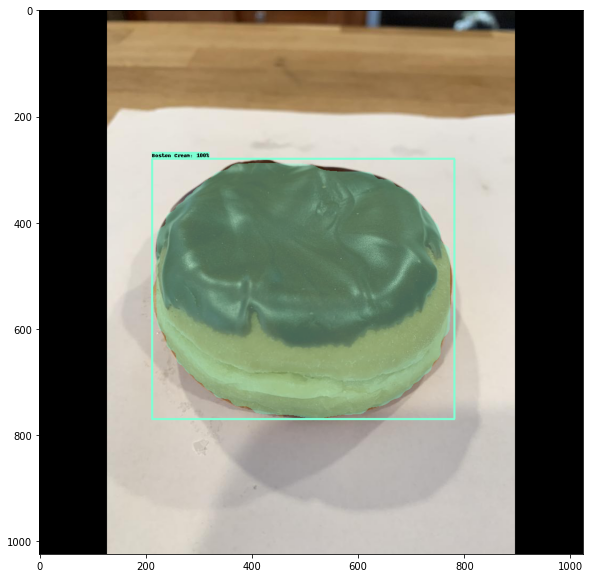

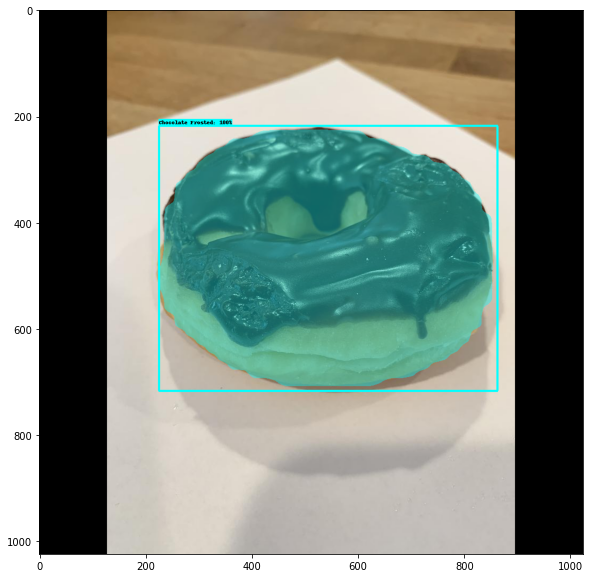

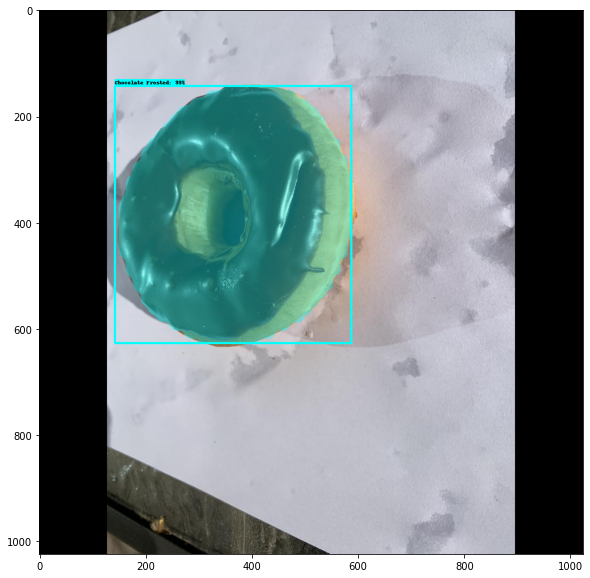

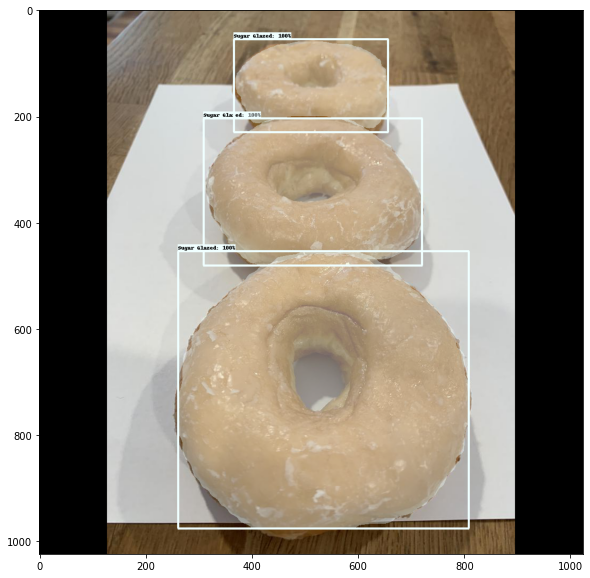

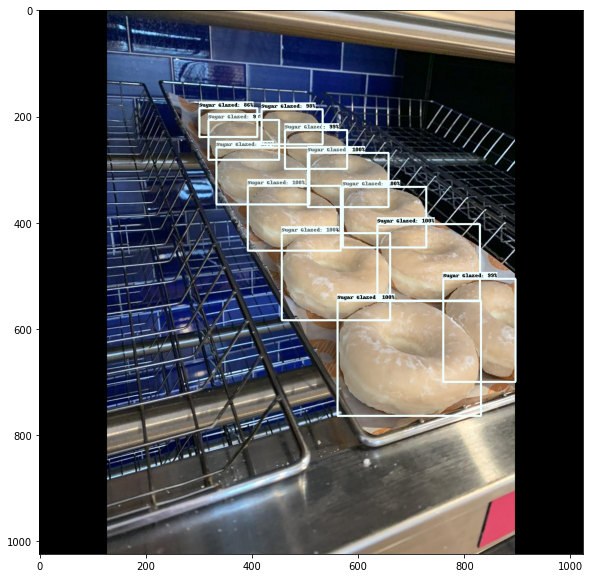

...

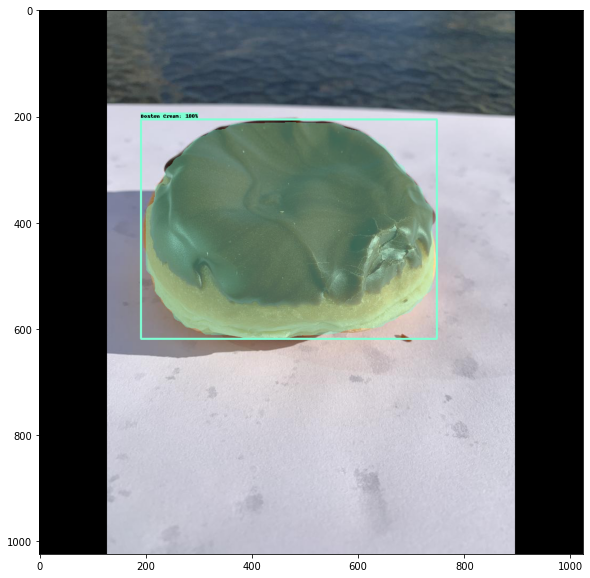

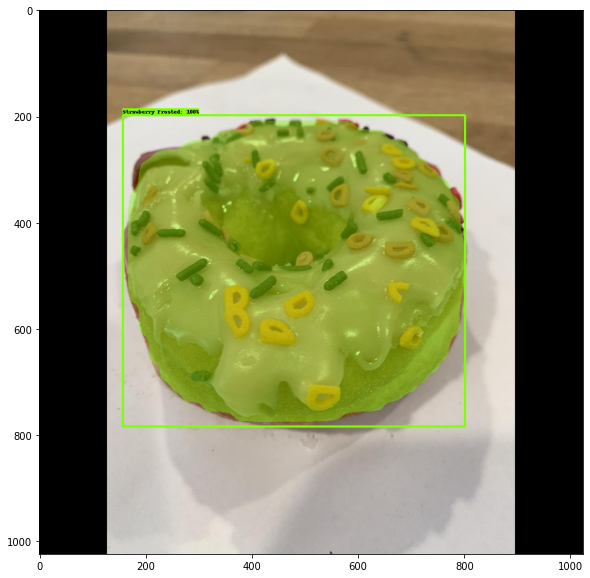

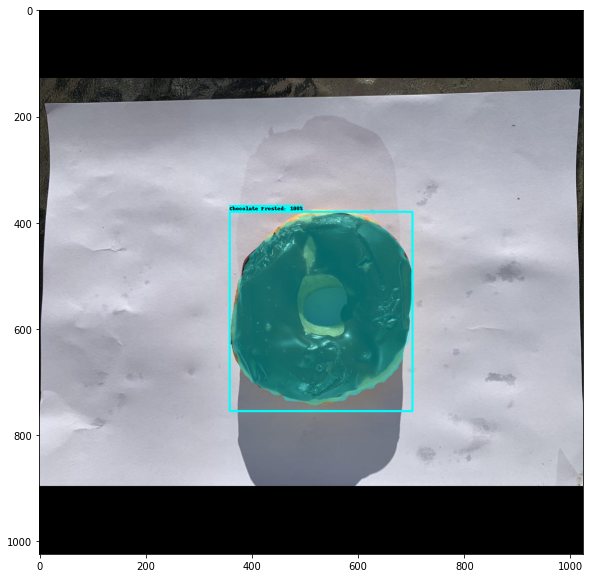

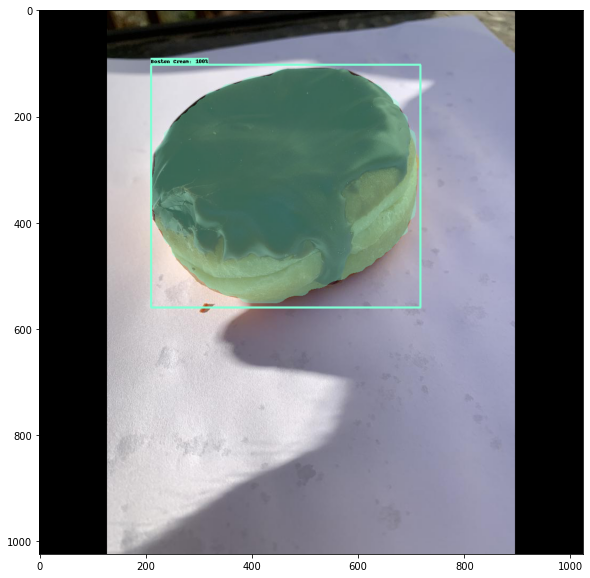

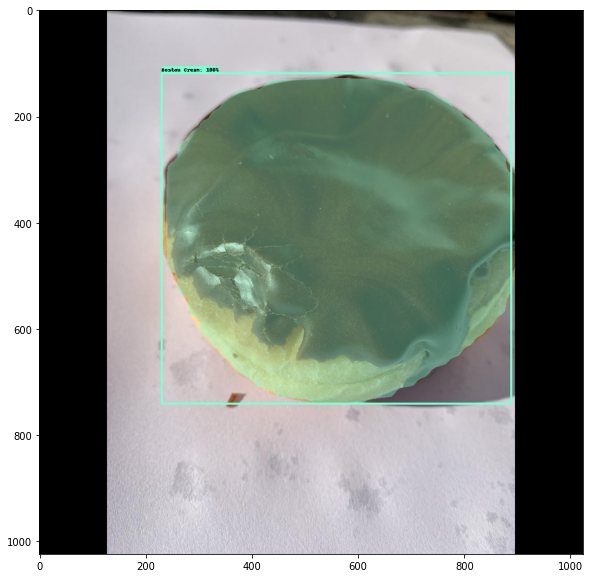

In [34]:
def load_image_into_numpy_array(path):
    """Load an image from file into a numpy array"""
    return np.array(Image.open(path))


for image_path in IMAGE_PATHS:
    
    image_np = load_image_into_numpy_array(image_path)

    # The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
    input_tensor = tf.convert_to_tensor(image_np)
    # The model expects a batch of images, so add an axis with `tf.newaxis`.
    input_tensor = input_tensor[tf.newaxis, ...]

    # input_tensor = np.expand_dims(image_np, 0)
    detections = detect_fn(input_tensor)
    # detection_classes should be ints.
    image_np_with_detections = image_np.copy()

   
    # The following processing is only for single image
    detection_boxes = tf.squeeze(detections['detection_boxes'], [0])
    detection_masks = tf.squeeze(detections['detection_masks'], [0])
    # Reframe is required to translate mask from box coordinates to image coordinates and fit the image size.
    real_num_detection = tf.cast(detections['num_detections'][0], tf.int32)
    detection_boxes = tf.slice(detection_boxes, [0, 0],
                               [real_num_detection, -1])
    detection_masks = tf.slice(detection_masks, [0, 0, 0],
                               [real_num_detection, -1, -1])
    detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
        detection_masks, detection_boxes, image_np.shape[0], image_np.shape[1])
    detection_masks_reframed = tf.cast(
        tf.greater(detection_masks_reframed, 0.5), tf.uint8)
    
    # Follow the convention by adding back the batch dimension
    detections['detection_masks'] = tf.expand_dims(detection_masks_reframed, 0)

    detections['num_detections'] = int(detections['num_detections'][0])
    detections['detection_classes'] = detections['detection_classes'][0].numpy(
    ).astype(np.uint8)
    
    detections['detection_boxes'] = detections['detection_boxes'][0].numpy()
    detections['detection_scores'] = detections['detection_scores'][0].numpy()
    detections['detection_masks'] = detections['detection_masks'][0].numpy()
  

    viz_utils.visualize_boxes_and_labels_on_image_array(
        image_np_with_detections,
        detections['detection_boxes'],
        detections['detection_classes'],
        detections['detection_scores'],
        category_index,
        instance_masks=detections.get('detection_masks'),
        use_normalized_coordinates=True,
        max_boxes_to_draw=30,
        min_score_thresh=.50)
    
    
    plt.figure(figsize=(10, 10))
    plt.imshow(image_np_with_detections)
    

    (filepath, filename) = os.path.split(image_path)
    if not os.path.exists(SAVE_DIR):
        os.makedirs(SAVE_DIR)
    save_path = os.path.join(SAVE_DIR, filename)
    plt.savefig(save_path)

plt.show()


In [37]:
!zip -r /content/inference-before-results.zip /content/models/research/object_detection/images/test_annotated

updating: content/models/research/object_detection/images/test_annotated/ (stored 0%)
updating: content/models/research/object_detection/images/test_annotated/BostonCream_0365.JPEG (deflated 12%)
updating: content/models/research/object_detection/images/test_annotated/ChocolateFrosted_0483.JPEG (deflated 11%)
updating: content/models/research/object_detection/images/test_annotated/ChocolateFrosted_0288.JPEG (deflated 9%)
updating: content/models/research/object_detection/images/test_annotated/Glazed_0443.JPEG (deflated 9%)
updating: content/models/research/object_detection/images/test_annotated/IMG_0613.JPEG (deflated 5%)
updating: content/models/research/object_detection/images/test_annotated/IMG_0642.JPEG (deflated 6%)
updating: content/models/research/object_detection/images/test_annotated/ChocolateFrosted_0452.JPEG (deflated 11%)
updating: content/models/research/object_detection/images/test_annotated/BostonCream_0369.JPEG (deflated 11%)
updating: content/models/research/object_det

## Download the SavedModel

In [ ]:
!zip -r /content/model.zip /content/models/research/object_detection/inference_graph/saved_model

updating: content/models/research/object_detection/inference_graph/saved_model/ (stored 0%)
updating: content/models/research/object_detection/inference_graph/saved_model/variables/ (stored 0%)
updating: content/models/research/object_detection/inference_graph/saved_model/variables/variables.index (deflated 81%)
updating: content/models/research/object_detection/inference_graph/saved_model/variables/variables.data-00000-of-00001 (deflated 7%)
updating: content/models/research/object_detection/inference_graph/saved_model/assets/ (stored 0%)
updating: content/models/research/object_detection/inference_graph/saved_model/saved_model.pb (deflated 93%)


In [ ]:
from google.colab import files
files.download("/content/model.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>